*   Projeto Final
*   Aluno: Afonso Isaque Araujo de Souza
*   Disciplina: Modelos Preditivos Conexionistas

# Importando Yolov5 e bibliotecas necessárias

In [ ]:

!git clone https://github.com/ultralytics/yolov5  
%cd yolov5
%pip install -qr requirements.txt #
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

fatal: destination path 'yolov5' already exists and is not an empty directory.
/content/yolov5
Setup complete. Using torch 1.12.1+cu113 (Tesla T4)


In [ ]:
!pip install joblib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# Importando dataset do Roboflow

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="khLZtNCKJewvw00pJxPt")
project = rf.workspace("cesar-school-ps-graduao").project("projeto-final-modelos-preditivos-conexionistas")
dataset = project.version(1).download("yolov5")

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to Projeto-Final---Modelos-preditivos-conexionistas-1 in yolov5pytorch:: 100%|██████████| 650/650 [00:00<00:00, 856.46it/s]


In [ ]:

%load_ext tensorboard
%tensorboard --logdir runs/train

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 923), started 0:11:29 ago. (Use '!kill 923' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:

%pip install -q wandb
import wandb

In [ ]:
import sys

def wandb_colab_login():
  """Temporary hack to prevent colab from hanging"""
  sys.modules["google.colab2"] = sys.modules["google.colab"]
  del sys.modules["google.colab"]
  wandb.login()
  sys.modules["google.colab"] = sys.modules["google.colab2"]
wandb_colab_login()

In [ ]:
from google.colab import drive

drive.mount('/content/gdrive/')

Drive already mounted at /content/gdrive/; to attempt to forcibly remount, call drive.mount("/content/gdrive/", force_remount=True).


In [ ]:
!python train.py --img 319 --batch 64 --epochs 1000 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache

wandb: Currently logged in as: afonsoaraujoo. Use `wandb login --relogin` to force relogin
train: weights=yolov5s.pt, cfg=, data=/content/yolov5/Projeto-Final---Modelos-preditivos-conexionistas-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=1000, batch_size=64, imgsz=319, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.2-226-gfde7758 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_mom

In [ ]:
%cp -r /content/yolov5/runs/train /content/gdrive/MyDrive/

# Métricas

In [ ]:

%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

# Inferência


In [ ]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 319 --conf 0.1 --source {dataset.location}/test/images

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/yolov5/Projeto-Final---Modelos-preditivos-conexionistas-1/test/images, data=data/coco128.yaml, imgsz=[319, 319], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-226-gfde7758 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7020913 parameters, 0 gradients, 15.8 GFLOPs
WARNING ⚠️ --img-size [319, 319] must be multiple of max stride 32, updating to [320, 320]
image 1/33 /content/yolov5/Projeto-Final---Modelos-preditivos-conexionistas-1/test/images/1498036112-dr-teddy-altman-ga_jpg.rf.c7b880161c7dd902810163e317d15385.jpg: 320x320 1 Capacete, 1 Jaleco, 7.

## Imagens de Teste

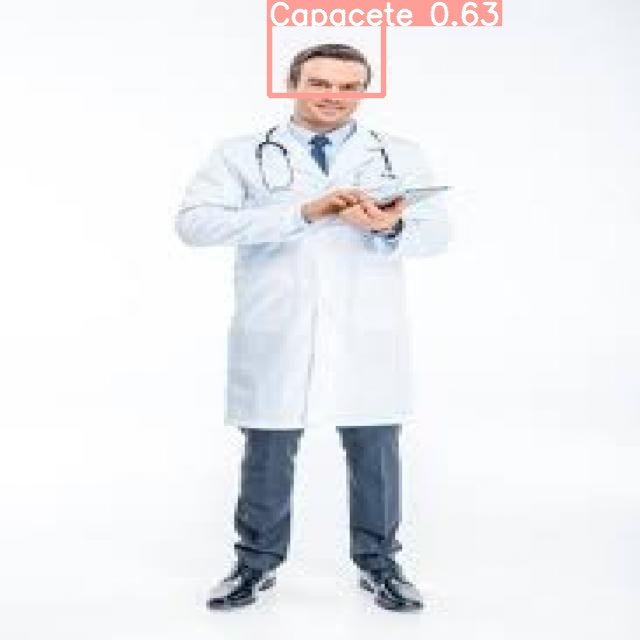

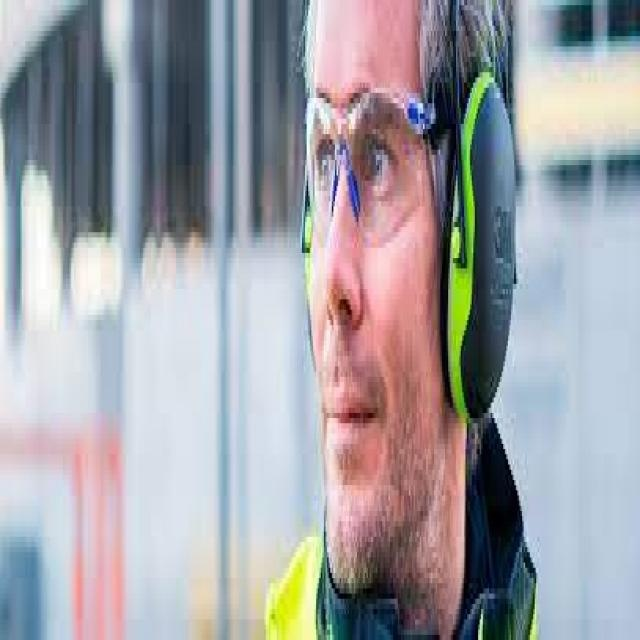

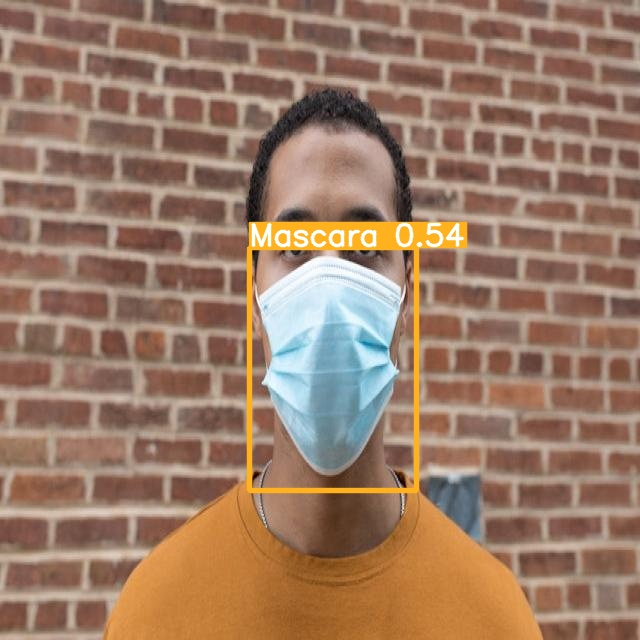

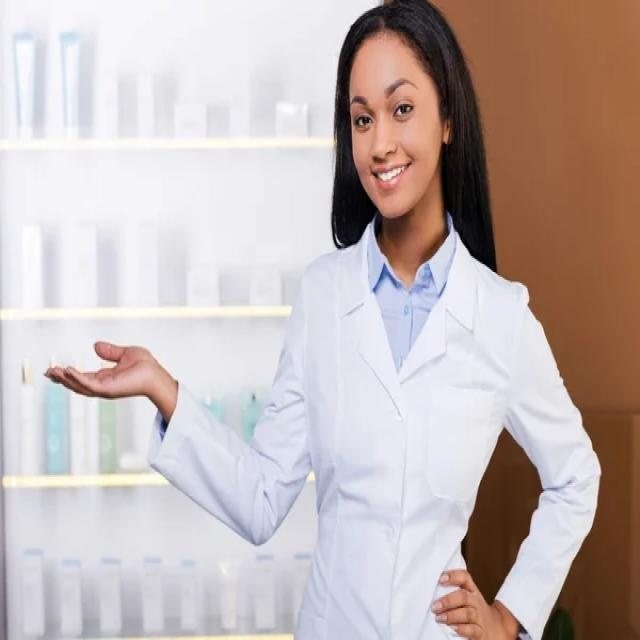

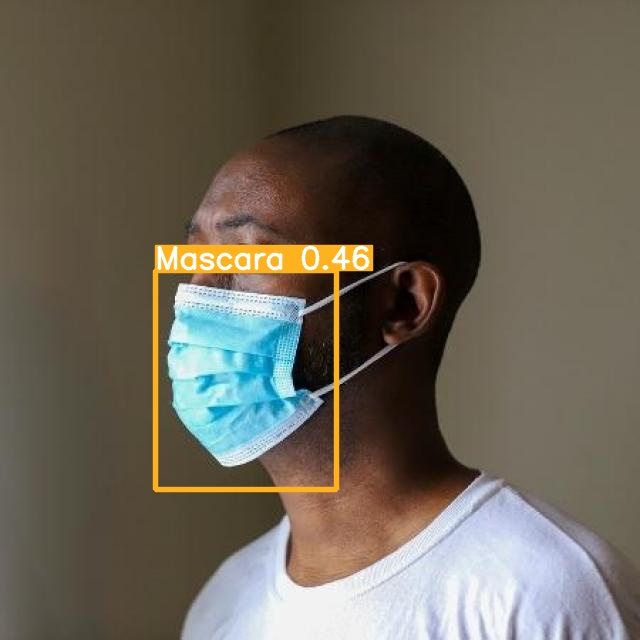

...

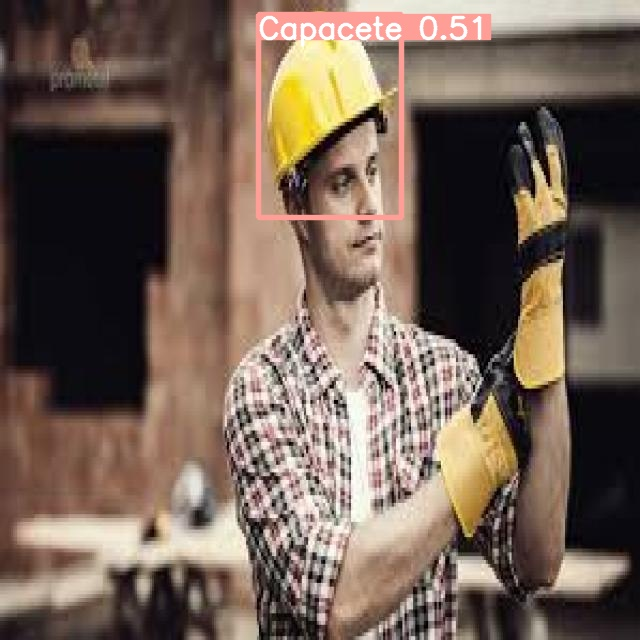

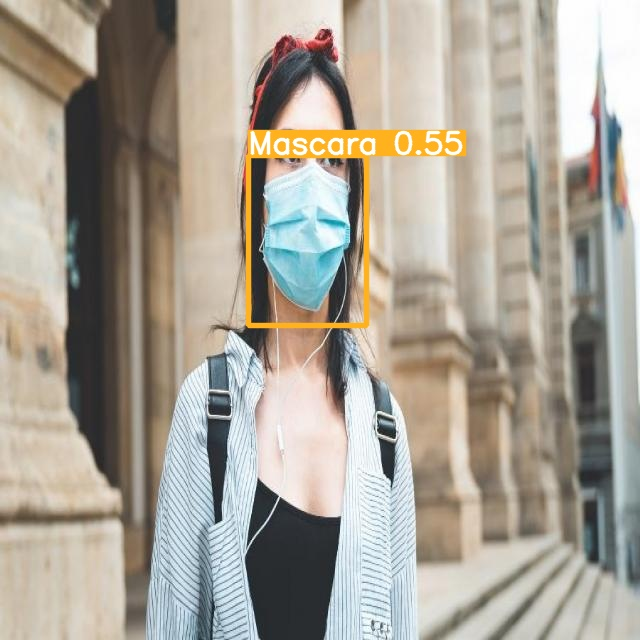

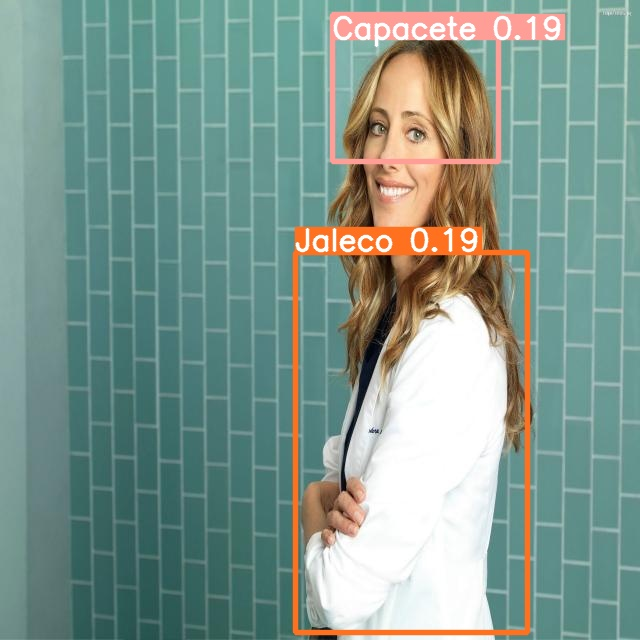

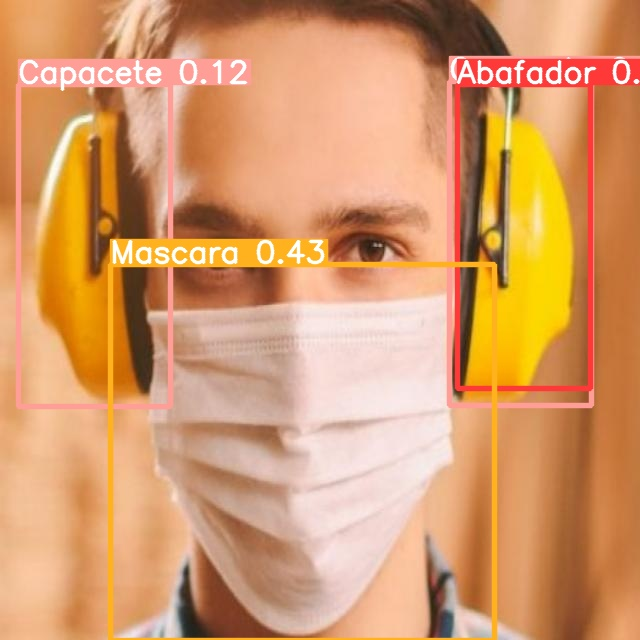

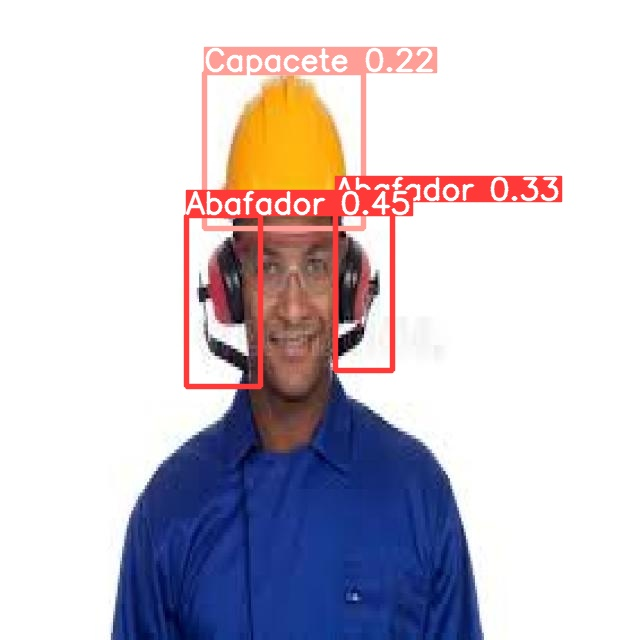

In [ ]:

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [ ]:
#export your model's weights for future use
from google.colab import files
files.download('./runs/train/exp/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>